In [1]:
#Single Encoder
#BottleNeck: 12

In [2]:
#Disable Warning
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

In [3]:
FILE1 = 'SB-001_normalized_AM.csv'
FILE2 = 'SB-001_normalized_PM.csv'
NO_OF_COLUMNS = 24

In [4]:
#pip install tf2onnx
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
import matplotlib.pyplot as plt
plt.ioff()
import cv2
import IPython
from tqdm import tqdm
import time
import os
import pickle
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings('ignore', message=r'.*Consider either turning off auto-sharding.*')

In [5]:
run_summary = []

In [6]:
def generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers):

    print(encoder_dense_layers, bottle_neck, decoder_dense_layers)
    # Load Data
    df_am = pd.read_csv(FILE1)
    df_pm = pd.read_csv(FILE2)
    combined_df = pd.concat([df_am, df_pm])

    columns_needed = ['y_am_pef', 'tempin', 'humidin', 'pm25in', 'co2in', 'tempdiffin', 'humidiffin', 'pm25diffin',
                      'pm10', 'pm25', 'o3', 'no2', 'co', 'so2', 'temp', 'windsd', 'humid', 'varp', 'dewpt', 'airp',
                      'seap', 'solrhr', 'solramnt', 'grdt', 'class']
    combined_df = combined_df.filter(columns_needed)
    df = combined_df.sample(frac=1, random_state=42).reset_index(drop=True)

    # Drop NaN
    df = df.dropna()

    # Minotity Split
    class_counts = df['class'].value_counts()
    minority_class = df[df['class'] == 0]
    majority_class = df[df['class'] == 1]

    # Removing class column from minority before augmentation
    X = minority_class.drop('class', axis=1)
    y = minority_class['class']

    # Saving minority as X_train
    X_train = X

    # Define the Input shape
    INPUT_SHAPE = X_train.shape[1]
    FILE_NAME = f"L{INPUT_SHAPE}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"
    print("\n" + FILE_NAME + "\n")
    
    def build_autoencoder(input_shape, **kwargs):

        # Autoencoder model construction cod

      """
      Build an autoencoder model with the given configuration.

      Args:
          input_shape (int): The shape of the input data.
          **kwargs: Additional keyword arguments for configuring the autoencoder.

      Keyword Args:
          encoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the encoder.
                                      Default: []
          bottle_neck (int): The number of units in the bottleneck layer. Default: input_shape // 2
          decoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the decoder.
                                      Default: []
          decoder_activation (str): The activation function for the decoder output layer. Default: 'sigmoid'

      Returns:
          tuple: A tuple containing the autoencoder, encoder, and decoder models.

      Example:
          INPUT_SHAPE = 27
          encoder_dense_layers = [20, 18]  # Specify the number of units for each dense layer in the encoder
          bottle_neck = 16
          decoder_dense_layers = [18, 20]  # Specify the number of units for each dense layer in the decoder

          autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                            bottle_neck=bottle_neck, decoder_dense_layers=decoder_dense_layers)
          encoder.summary()
          decoder.summary()
          autoencoder.summary()
      """

      # Default parameter values
      encoder_dense_layers = kwargs.get('encoder_dense_layers', [])
      bottle_neck = kwargs.get('bottle_neck', input_shape // 2)
      decoder_dense_layers = kwargs.get('decoder_dense_layers', [])
      decoder_activation = kwargs.get('decoder_activation', 'sigmoid')

      # Autoencoder Model
      encoder_input = keras.Input(shape=(input_shape,), name="encoder")
      x = keras.layers.Flatten()(encoder_input)

      # Encoder Dense Layers
      for units in encoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      encoder_output = keras.layers.Dense(bottle_neck, activation="relu")(x)
      encoder = keras.Model(encoder_input, encoder_output, name="encoder")

      # Decoder Model
      decoder_input = keras.Input(shape=(bottle_neck,), name="decoder")
      x = decoder_input

      # Decoder Dense Layers
      for units in decoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      decoder_output = keras.layers.Dense(input_shape, activation=decoder_activation)(x)
      decoder = keras.Model(decoder_input, decoder_output, name="decoder")

      # Autoencoder Model
      autoencoder_input = keras.Input(shape=(input_shape,), name="input")
      encoded = encoder(autoencoder_input)
      decoded = decoder(encoded)
      autoencoder = keras.Model(autoencoder_input, decoded, name="autoencoder")

      return autoencoder, encoder, decoder

    autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                      bottle_neck=bottle_neck,
                                                      decoder_dense_layers=decoder_dense_layers)
    opt = keras.optimizers.Adam(learning_rate=0.001)
    autoencoder.compile(opt, loss="mse")

    print("Training model:", FILE_NAME)
    history = autoencoder.fit(X_train, X_train, epochs=200, batch_size=16, validation_split=0.25, verbose=0)
    print("Training Complete:")
    
    # Extract the loss values
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # Print the last epoch's loss values
    last_epoch_loss = loss[-1]
    last_epoch_val_loss = val_loss[-1]
    print("Last epoch loss:", last_epoch_loss)
    print("Last epoch validation loss:", last_epoch_val_loss)

    # Saving history
    with open(FILE_NAME + '_history.pickle', 'wb') as file:
        pickle.dump(history.history, file)

    # Visualize losses *(MSE)
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)
    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(FILE_NAME + 'Loss.png')
    #plt.show()

    # Generate synthetic data
    num_samples = len(X_train)
    input_data = np.random.normal(size=(num_samples, INPUT_SHAPE))
    generated_data = autoencoder.predict(input_data)
    reshaped_data = generated_data.reshape(num_samples, -1)
    df_generated = pd.DataFrame(reshaped_data, columns=X_train.columns)

    # Plot correlation matrices
    corr_matrix1 = X_train.corr()
    corr_matrix2 = df_generated.corr()

    fig, axes = plt.subplots(1, 2, figsize=(18, 10))
    sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', ax=axes[0])
    axes[0].set_title('Heatmap 1')

    sns.heatmap(corr_matrix2, annot=True, cmap='coolwarm', ax=axes[1])
    axes[1].set_title('Heatmap 2')

    plt.tight_layout()
    plt.savefig(FILE_NAME + 'HeatMaps')
    #plt.show()

    # Calculate mean and standard deviation of original and synthetic datasets
    common_columns = set(X_train.columns) & set(df_generated.columns)
    results = {}

    for column in common_columns:
        mean_df1 = X_train[column].mean()
        std_df1 = X_train[column].std()
        mean_df2 = df_generated[column].mean()
        std_df2 = df_generated[column].std()

        results[column] = {'Mean_df1': mean_df1, 'Std_df1': std_df1,
                           'Mean_df2': mean_df2, 'Std_df2': std_df2}

    comparison_df = pd.DataFrame(results)
    comparison_df.to_csv(FILE_NAME + 'mean_std.csv', index=True)

    # Plot scatter plots
    new_index = pd.RangeIndex(start=0, stop=57, step=1)
    X_train = X_train.set_index(new_index)
    common_columns = set(X_train.columns) & set(df_generated.columns)

    for column in common_columns:
        plt.scatter(X_train.index, X_train[column], color='red', label='X_train')
        plt.scatter(df_generated.index, df_generated[column], color='blue', label='df_generated')

        plt.title(f"Scatter Plot: {column}")
        plt.xlabel("Index")
        plt.ylabel(column)

        plt.legend()
        plt.savefig(FILE_NAME + "_" + column)
        #plt.show()


    # Add back the class label
    X_train['class'] = 0.0
    df_generated['class'] = 0.0
    X_train.to_csv(FILE_NAME + 'Original_minority_data.csv', index=False)
    df_generated.to_csv(FILE_NAME + 'Synthetic_minority_data.csv', index=False)

    # Generate quality report and display it
    real_data = FILE_NAME + 'Original_minority_data.csv'
    synth_data = FILE_NAME + 'Synthetic_minority_data.csv'

    # report = QualityReport(data_source=synth_data, ref_data=real_data)
    # report.run()

    # print(report.peek())
    #run_summary.append([FILE_NAME, report.peek()['raw_score'], report.peek()['grade']])
    run_summary.append([FILE_NAME, last_epoch_loss, last_epoch_val_loss])

    print("Reports Saved")
    #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))
    return None

In [7]:
# Example usage
def runner(encoder_dense_layers, bottle_neck, decoder_dense_layers):
  #encoder_dense_layers = [10, 8]
  #bottle_neck = 5
  #decoder_dense_layers = [8, 10]
  #FILE_NAME = f"24_{'_'.join(map(str, encoder_dense_layers))}_{bottle_neck}_"
  FILE_NAME = f"L{NO_OF_COLUMNS}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"   
  report = generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers)
  #print(type(report))
  # Save the report object to a file
  # with open(FILE_NAME + 'quality_report.pickle', 'wb') as file:
  #     pickle.dump(report, file)

  #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))

In [8]:
# here goes nothin

In [9]:
encoder_dense_layers_trial = [[8], [10], [12], [14], [16], [18] ,[20]]
decoder_dense_layers_trial = [[8, 10], [10, 12], [12, 14], [14, 16], [16, 18], [18, 20], [20,22]]
bottle_neck_trial = [12]

In [10]:
total_iterations = len(bottle_neck_trial) * len(encoder_dense_layers_trial) * len(decoder_dense_layers_trial)
print("Total Model in Pipeline:",total_iterations)

# Print total models
for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)

Total Model in Pipeline: 49
[8] 12 [8, 10]
[8] 12 [10, 12]
[8] 12 [12, 14]
[8] 12 [14, 16]
[8] 12 [16, 18]
[8] 12 [18, 20]
[8] 12 [20, 22]
[10] 12 [8, 10]
[10] 12 [10, 12]
[10] 12 [12, 14]
[10] 12 [14, 16]
[10] 12 [16, 18]
[10] 12 [18, 20]
[10] 12 [20, 22]
[12] 12 [8, 10]
[12] 12 [10, 12]
[12] 12 [12, 14]
[12] 12 [14, 16]
[12] 12 [16, 18]
[12] 12 [18, 20]
[12] 12 [20, 22]
[14] 12 [8, 10]
[14] 12 [10, 12]
[14] 12 [12, 14]
[14] 12 [14, 16]
[14] 12 [16, 18]
[14] 12 [18, 20]
[14] 12 [20, 22]
[16] 12 [8, 10]
[16] 12 [10, 12]
[16] 12 [12, 14]
[16] 12 [14, 16]
[16] 12 [16, 18]
[16] 12 [18, 20]
[16] 12 [20, 22]
[18] 12 [8, 10]
[18] 12 [10, 12]
[18] 12 [12, 14]
[18] 12 [14, 16]
[18] 12 [16, 18]
[18] 12 [18, 20]
[18] 12 [20, 22]
[20] 12 [8, 10]
[20] 12 [10, 12]
[20] 12 [12, 14]
[20] 12 [14, 16]
[20] 12 [16, 18]
[20] 12 [18, 20]
[20] 12 [20, 22]


[8] 12 [8, 10]
[8] 12 [8, 10]

L24_E8_B12_D8_10

Training model: L24_E8_B12_D8_10
Training Complete:
Last epoch loss: 0.012645943090319633
Last epoch validation loss: 0.018668437376618385
Reports Saved
[8] 12 [10, 12]
[8] 12 [10, 12]

L24_E8_B12_D10_12

Training model: L24_E8_B12_D10_12
Training Complete:
Last epoch loss: 0.018314817920327187
Last epoch validation loss: 0.027872640639543533
Reports Saved
[8] 12 [12, 14]
[8] 12 [12, 14]

L24_E8_B12_D12_14

Training model: L24_E8_B12_D12_14
Training Complete:
Last epoch loss: 0.01088592316955328
Last epoch validation loss: 0.01842655800282955
Reports Saved
[8] 12 [14, 16]
[8] 12 [14, 16]

L24_E8_B12_D14_16

Training model: L24_E8_B12_D14_16
Training Complete:
Last epoch loss: 0.009969290345907211
Last epoch validation loss: 0.01563427597284317
Reports Saved
[8] 12 [16, 18]
[8] 12 [16, 18]

L24_E8_B12_D16_18

Training model: L24_E8_B12_D16_18
Training Complete:
Last epoch loss: 0.011650996282696724
Last epoch validation loss: 0.0178714878

Reports Saved
[10] 12 [18, 20]
[10] 12 [18, 20]

L24_E10_B12_D18_20

Training model: L24_E10_B12_D18_20
Training Complete:
Last epoch loss: 0.010839289054274559
Last epoch validation loss: 0.017834240570664406
Reports Saved
[10] 12 [20, 22]
[10] 12 [20, 22]

L24_E10_B12_D20_22

Training model: L24_E10_B12_D20_22
Training Complete:
Last epoch loss: 0.009866037406027317
Last epoch validation loss: 0.017280209809541702
Reports Saved
[12] 12 [8, 10]
[12] 12 [8, 10]

L24_E12_B12_D8_10

Training model: L24_E12_B12_D8_10
Training Complete:
Last epoch loss: 0.016374118626117706
Last epoch validation loss: 0.02442733198404312
Reports Saved
[12] 12 [10, 12]
[12] 12 [10, 12]

L24_E12_B12_D10_12

Training model: L24_E12_B12_D10_12
Training Complete:
Last epoch loss: 0.010394079610705376
Last epoch validation loss: 0.016272079199552536
Reports Saved
[12] 12 [12, 14]
[12] 12 [12, 14]

L24_E12_B12_D12_14

Training model: L24_E12_B12_D12_14
Training Complete:
Last epoch loss: 0.011015506461262703
Last

Reports Saved
[14] 12 [8, 10]
[14] 12 [8, 10]

L24_E14_B12_D8_10

Training model: L24_E14_B12_D8_10
Training Complete:
Last epoch loss: 0.009390492923557758
Last epoch validation loss: 0.015534842386841774
Reports Saved
[14] 12 [10, 12]
[14] 12 [10, 12]

L24_E14_B12_D10_12

Training model: L24_E14_B12_D10_12
Training Complete:
Last epoch loss: 0.011805444955825806
Last epoch validation loss: 0.017718320712447166
Reports Saved
[14] 12 [12, 14]
[14] 12 [12, 14]

L24_E14_B12_D12_14

Training model: L24_E14_B12_D12_14
Training Complete:
Last epoch loss: 0.011302066035568714
Last epoch validation loss: 0.019322296604514122
Reports Saved
[14] 12 [14, 16]
[14] 12 [14, 16]

L24_E14_B12_D14_16

Training model: L24_E14_B12_D14_16
Training Complete:
Last epoch loss: 0.00884302705526352
Last epoch validation loss: 0.014013219624757767
Reports Saved
[14] 12 [16, 18]
[14] 12 [16, 18]

L24_E14_B12_D16_18

Training model: L24_E14_B12_D16_18
Training Complete:
Last epoch loss: 0.009365896694362164
Last

Reports Saved
[16] 12 [12, 14]
[16] 12 [12, 14]

L24_E16_B12_D12_14

Training model: L24_E16_B12_D12_14
Training Complete:
Last epoch loss: 0.012232060544192791
Last epoch validation loss: 0.020252669230103493
Reports Saved
[16] 12 [14, 16]
[16] 12 [14, 16]

L24_E16_B12_D14_16

Training model: L24_E16_B12_D14_16
Training Complete:
Last epoch loss: 0.007962074130773544
Last epoch validation loss: 0.01463607233017683
Reports Saved
[16] 12 [16, 18]
[16] 12 [16, 18]

L24_E16_B12_D16_18

Training model: L24_E16_B12_D16_18
Training Complete:
Last epoch loss: 0.007555289659649134
Last epoch validation loss: 0.01456998661160469
Reports Saved
[16] 12 [18, 20]
[16] 12 [18, 20]

L24_E16_B12_D18_20

Training model: L24_E16_B12_D18_20
Training Complete:
Last epoch loss: 0.005754061508923769
Last epoch validation loss: 0.011287780478596687
Reports Saved
[16] 12 [20, 22]
[16] 12 [20, 22]

L24_E16_B12_D20_22

Training model: L24_E16_B12_D20_22
Training Complete:
Last epoch loss: 0.007962943986058235
L

Reports Saved
[18] 12 [16, 18]
[18] 12 [16, 18]

L24_E18_B12_D16_18

Training model: L24_E18_B12_D16_18
Training Complete:
Last epoch loss: 0.007510737515985966
Last epoch validation loss: 0.013316858559846878
Reports Saved
[18] 12 [18, 20]
[18] 12 [18, 20]

L24_E18_B12_D18_20

Training model: L24_E18_B12_D18_20
Training Complete:
Last epoch loss: 0.009728505276143551
Last epoch validation loss: 0.01653807796537876
Reports Saved
[18] 12 [20, 22]
[18] 12 [20, 22]

L24_E18_B12_D20_22

Training model: L24_E18_B12_D20_22
Training Complete:
Last epoch loss: 0.0065984586253762245
Last epoch validation loss: 0.01208192016929388
Reports Saved
[20] 12 [8, 10]
[20] 12 [8, 10]

L24_E20_B12_D8_10

Training model: L24_E20_B12_D8_10
Training Complete:
Last epoch loss: 0.011895951814949512
Last epoch validation loss: 0.016883306205272675
Reports Saved
[20] 12 [10, 12]
[20] 12 [10, 12]

L24_E20_B12_D10_12

Training model: L24_E20_B12_D10_12
Training Complete:
Last epoch loss: 0.009939855895936489
Last

Reports Saved
[20] 12 [20, 22]
[20] 12 [20, 22]

L24_E20_B12_D20_22

Training model: L24_E20_B12_D20_22
Training Complete:
Last epoch loss: 0.008327347226440907
Last epoch validation loss: 0.015120219439268112
Reports Saved
Total time: 48.67865092754364 minutes


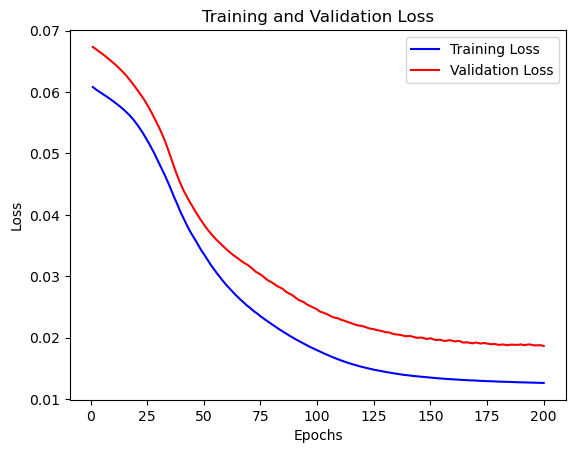

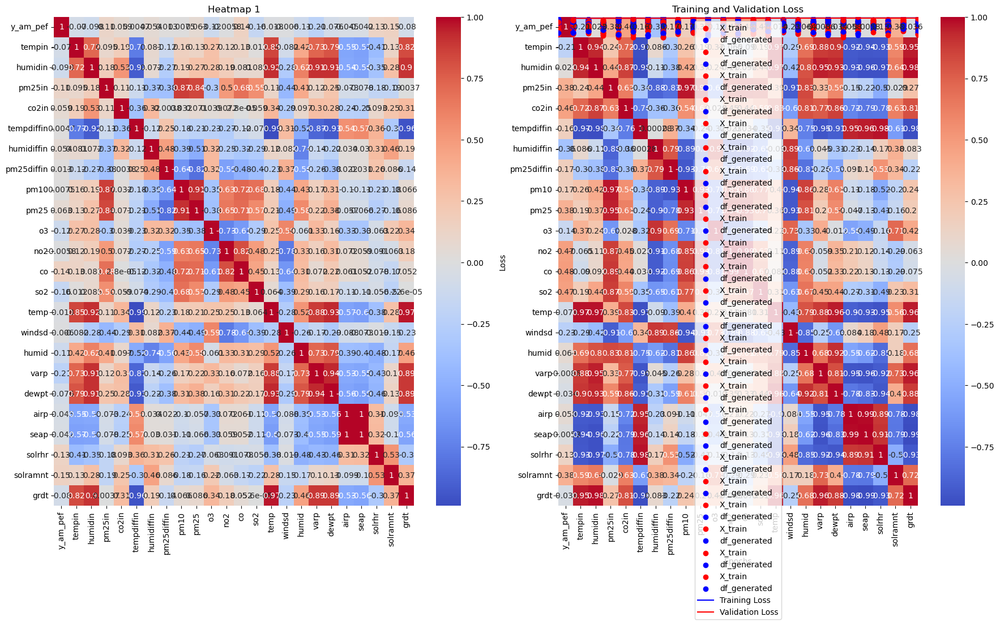

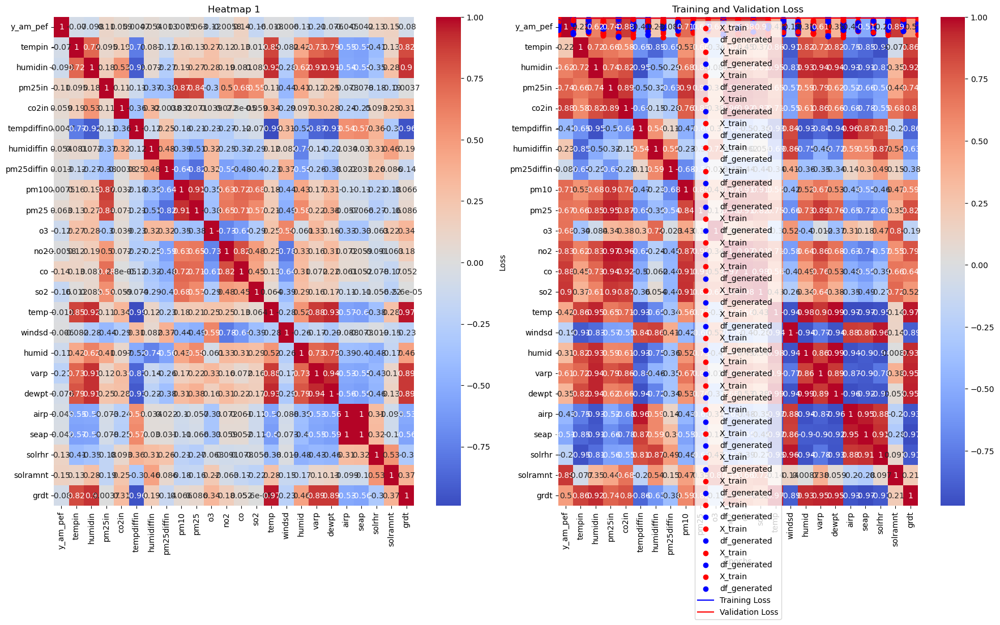

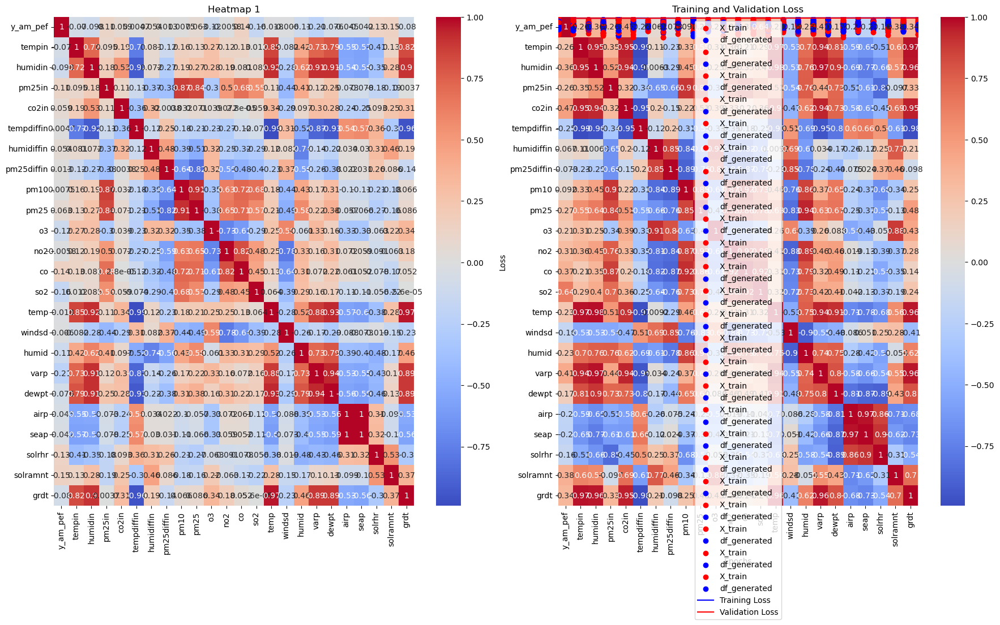

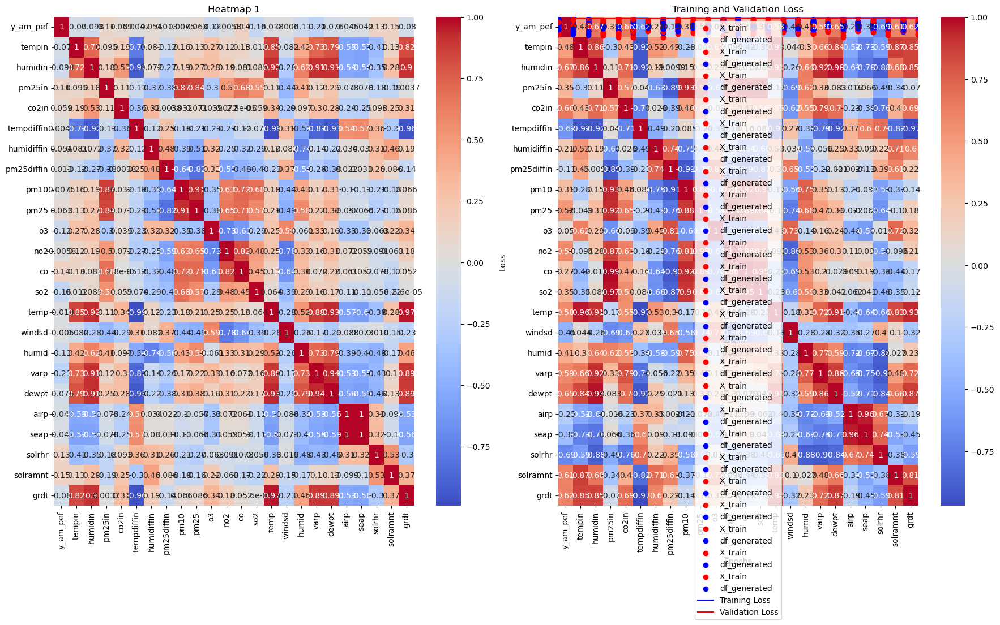

...

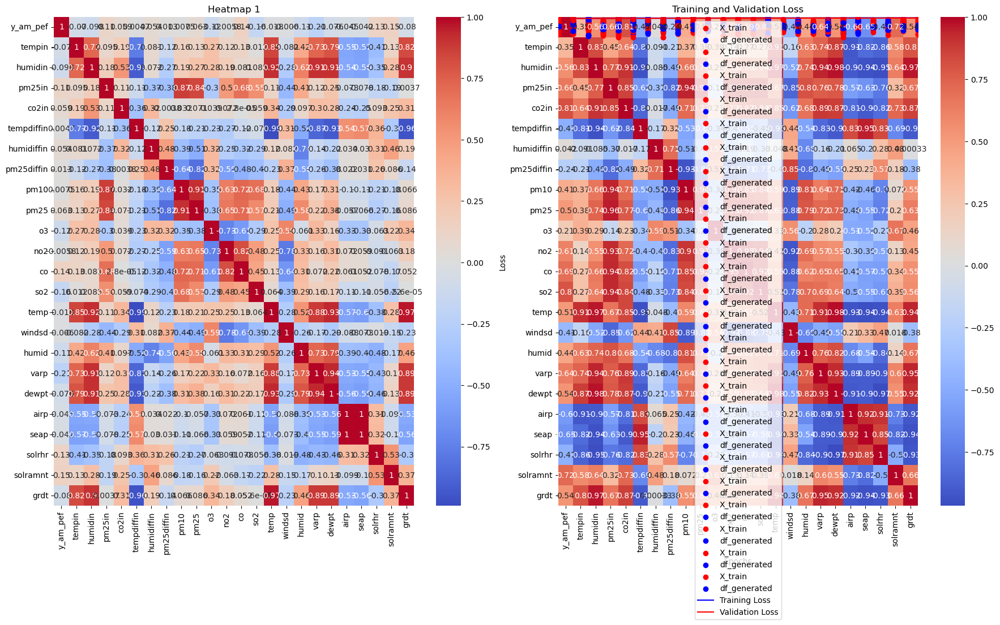

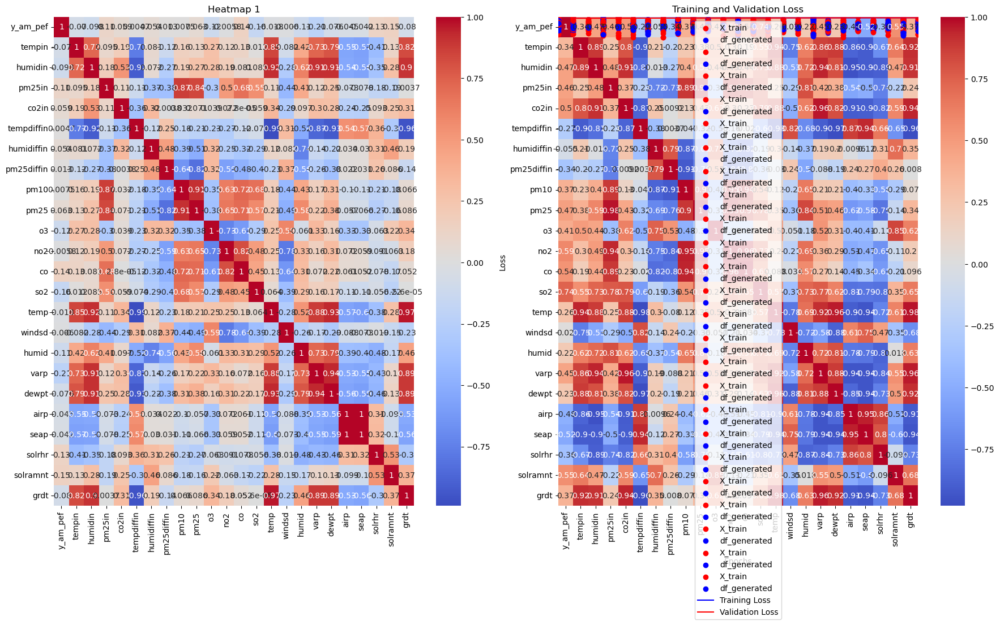

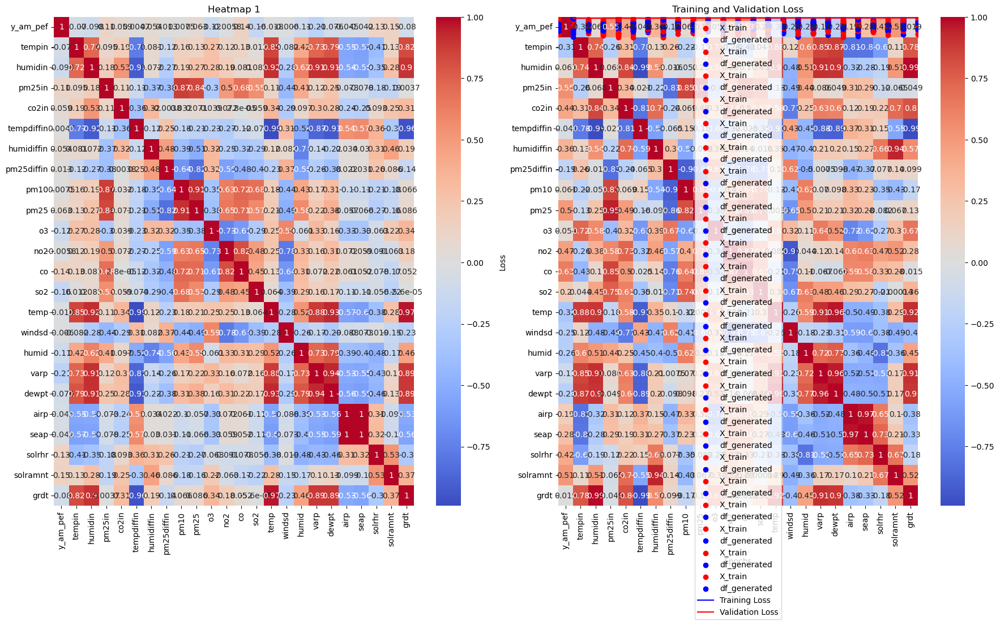

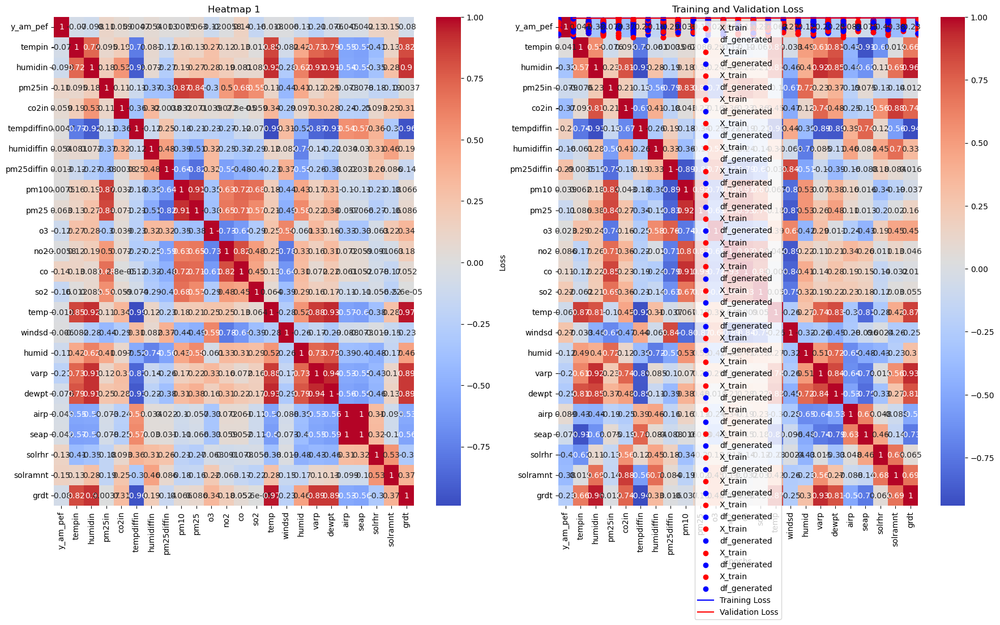

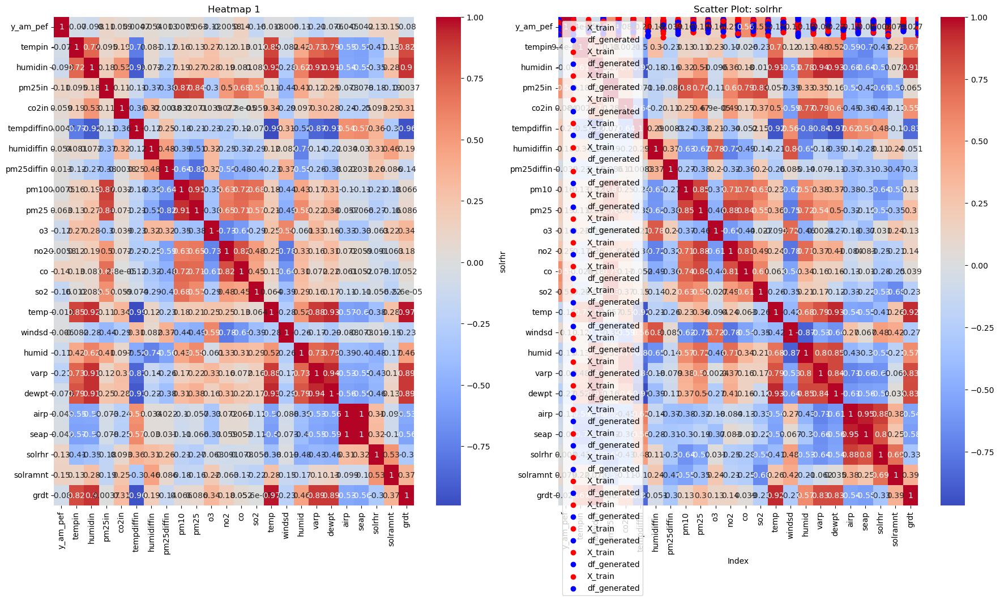

In [11]:
start_time = time.time()

for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)
          runner(enc_layers, bn, dec_layers)
                
end_time = time.time()
total_time = end_time - start_time                
total_time_minutes = total_time / 60
print(f"Total time: {total_time_minutes} minutes") 

In [12]:
import csv
#save run_summary as a file
filename = 'run_summary.csv'

with open(filename, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(run_summary)

print(f"Run summary has saved: {filename}")

Run summary has saved: run_summary.csv


In [13]:
run_summary.sort(key=lambda x: x[1], reverse=True)  # Sort by the middle value in descending order

top_10 = run_summary[:10]  # Get the top 10 elements

for item in top_10:
    print(item)

['L24_E8_B12_D10_12', 0.018314817920327187, 0.027872640639543533]
['L24_E16_B12_D10_12', 0.016757391393184662, 0.025829460471868515]
['L24_E12_B12_D8_10', 0.016374118626117706, 0.02442733198404312]
['L24_E10_B12_D8_10', 0.015091272071003914, 0.022809140384197235]
['L24_E18_B12_D10_12', 0.015057547017931938, 0.019893638789653778]
['L24_E20_B12_D14_16', 0.013013070449233055, 0.021087275817990303]
['L24_E10_B12_D14_16', 0.012892795726656914, 0.018959740176796913]
['L24_E8_B12_D8_10', 0.012645943090319633, 0.018668437376618385]
['L24_E16_B12_D8_10', 0.012458034791052341, 0.01846136897802353]
['L24_E18_B12_D8_10', 0.012447400018572807, 0.019158773124217987]


In [14]:
for item in run_summary:
    print(item)

['L24_E8_B12_D10_12', 0.018314817920327187, 0.027872640639543533]
['L24_E16_B12_D10_12', 0.016757391393184662, 0.025829460471868515]
['L24_E12_B12_D8_10', 0.016374118626117706, 0.02442733198404312]
['L24_E10_B12_D8_10', 0.015091272071003914, 0.022809140384197235]
['L24_E18_B12_D10_12', 0.015057547017931938, 0.019893638789653778]
['L24_E20_B12_D14_16', 0.013013070449233055, 0.021087275817990303]
['L24_E10_B12_D14_16', 0.012892795726656914, 0.018959740176796913]
['L24_E8_B12_D8_10', 0.012645943090319633, 0.018668437376618385]
['L24_E16_B12_D8_10', 0.012458034791052341, 0.01846136897802353]
['L24_E18_B12_D8_10', 0.012447400018572807, 0.019158773124217987]
['L24_E10_B12_D12_14', 0.01242231484502554, 0.018290428444743156]
['L24_E16_B12_D12_14', 0.012232060544192791, 0.020252669230103493]
['L24_E12_B12_D14_16', 0.012180892750620842, 0.0183943510055542]
['L24_E20_B12_D8_10', 0.011895951814949512, 0.016883306205272675]
['L24_E14_B12_D10_12', 0.011805444955825806, 0.017718320712447166]
['L24_E8